In [14]:
# Importing the Libraries
import cv2 as cv
import math
import time
from google.colab.patches import cv2_imshow

In [15]:
# Function to detect faces in the frame and draw bounding boxes around them
def getFaceBox(net, frame, conf_threshold=0.7):
    framecvdnn = frame.copy()  # Create a copy of the input frame.
    frameheight = framecvdnn.shape[0]  # Get the height of the frame.
    framewidth = framecvdnn.shape[1]  # Get the width of the frame.

    # Preprocess the image to create a blob for the DNN model
    blob = cv.dnn.blobFromImage(framecvdnn, 1.0, (300, 300), [104, 117, 123], True, False)

    net.setInput(blob)  # Set the blob as input to the network.
    Detections = net.forward()  # Perform forward pass to get detections.
    bboxes = []  # Initialize an empty list to store bounding boxes.

    # Loop over all detections
    for i in range(Detections.shape[2]):
        confidence = Detections[0, 0, i, 2]  # Extract confidence of the detection.
        if confidence > conf_threshold:  # Only consider detections with confidence above threshold.
            x1 = int(Detections[0, 0, i, 3] * framewidth)  # Calculate the x-coordinate of the top-left corner.
            y1 = int(Detections[0, 0, i, 4] * frameheight)  # Calculate the y-coordinate of the top-left corner.
            x2 = int(Detections[0, 0, i, 5] * framewidth)  # Calculate the x-coordinate of the bottom-right corner.
            y2 = int(Detections[0, 0, i, 6] * frameheight)  # Calculate the y-coordinate of the bottom-right corner.
            bboxes.append([x1, y1, x2, y2])  # Append the bounding box to the list.
            # Draw a rectangle around the detected face
            cv.rectangle(framecvdnn, (x1, y1), (x2, y2), (0, 255, 0), int(round(frameheight/150)), 8)
    return framecvdnn, bboxes  # Return the frame with drawn rectangles and the bounding boxes.


In [16]:
# File paths for the model
faceProto = "/content/drive/MyDrive/Age And Gender Detection/opencv_face_detector.pbtxt"
faceModel = "/content/drive/MyDrive/Age And Gender Detection/opencv_face_detector_uint8.pb"

ageProto = "/content/drive/MyDrive/Age And Gender Detection/age_deploy.prototxt"
ageModel = "/content/drive/MyDrive/Age And Gender Detection/age_net.caffemodel"

genderProto = "/content/drive/MyDrive/Age And Gender Detection/gender_deploy.prototxt"
genderModel = "/content/drive/MyDrive/Age And Gender Detection/gender_net.caffemodel"

In [29]:
# Mean values for the age and gender models' input
MODEL_MEAN_VALUES = (78.4263377603, 87.7689143744, 114.895847746)
# Age categories used by the model
ageList = ['(0-2)', '(4-6)', '(8-12)', '(15-20)', '(25-32)', '(38-43)', '(48-53)', '(60-100)']
# Gender categories used by the model
genderList = ['Male','Female']


In [30]:
# Load the age, gender, and face detection models
agenet = cv.dnn.readNet(ageModel, ageProto)
gendernet = cv.dnn.readNet(genderModel, genderProto)
faceNet = cv.dnn.readNet(faceModel, faceProto)
# Padding around the detected face region for better age and gender prediction
padding = 20

In [31]:
# Function to detect age and gender in the input frame
def age_gender_detector(frame):
    t = time.time()  # Start time measurement.
    frameFace, bboxes = getFaceBox(faceNet, frame)  # Detect faces in the frame.
    for bbox in bboxes:
        # Extract the face region from the frame with padding
        face = frame[max(0, bbox[1] - padding):min(bbox[3] + padding, frame.shape[0] - 1),
                     max(0, bbox[0] - padding):min(bbox[2] + padding, frame.shape[1] - 1)]

        # Preprocess the face for age and gender prediction
        blob = cv.dnn.blobFromImage(face, 1.0, (227, 227), MODEL_MEAN_VALUES, swapRB=False)
        gendernet.setInput(blob)  # Set the face blob as input to the gender model.
        genderPreds = gendernet.forward()  # Perform forward pass to predict gender.
        gender = genderList[genderPreds[0].argmax()]  # Get the predicted gender label.

        agenet.setInput(blob)  # Set the face blob as input to the age model.
        agePreds = agenet.forward()  # Perform forward pass to predict age.
        age = ageList[agePreds[0].argmax()]  # Get the predicted age label.

        # Create a label with the predicted gender and age
        label = "{},{}".format(gender, age)
        # Put the label on the frame near the detected face
        cv.putText(frameFace, label, (bbox[0], bbox[1] - 10), cv.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 255), 2, cv.LINE_AA)
    return frameFace  # Return the frame with detected faces and predictions.


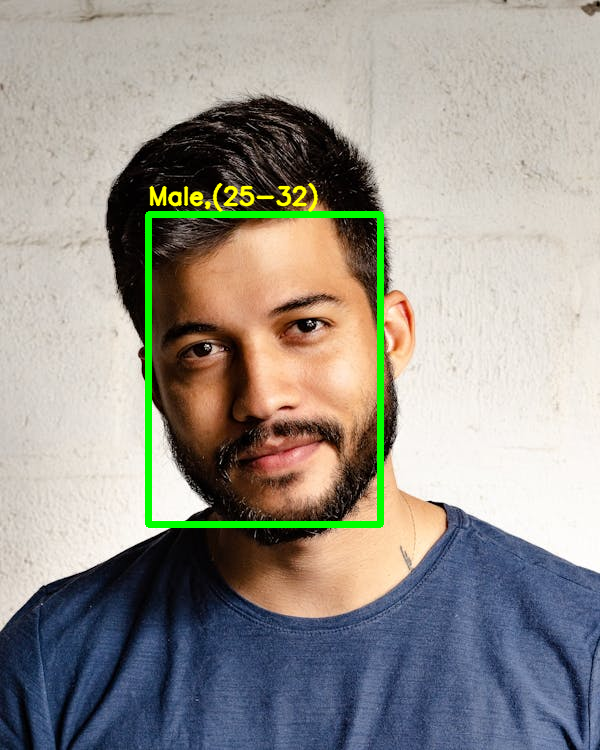

In [32]:
# Read an input image from a file
input = cv.imread("/content/drive/MyDrive/pexels-photo-2379005.jpeg")
# Perform age and gender detection on the input image
output = age_gender_detector(input)
# Display the output image with the detections
cv2_imshow(output)

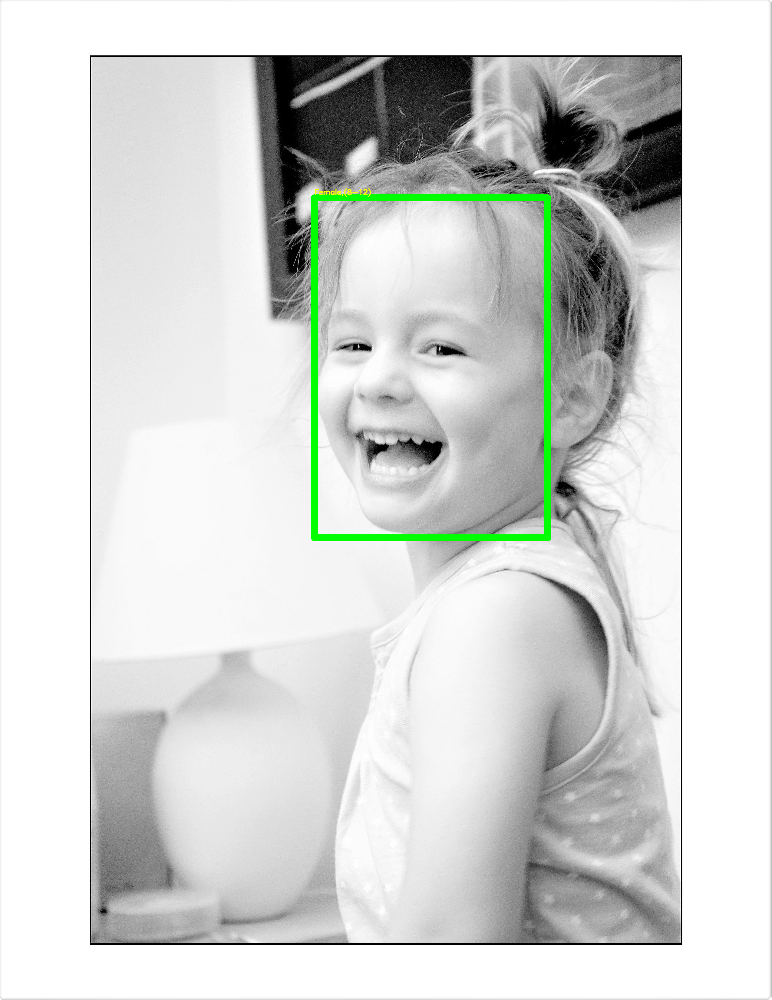

In [24]:
input = cv.imread("/content/drive/MyDrive/e64aea15de8642a5f5378011fe1bda82.jpg")
output = age_gender_detector(input)
cv2_imshow(output)

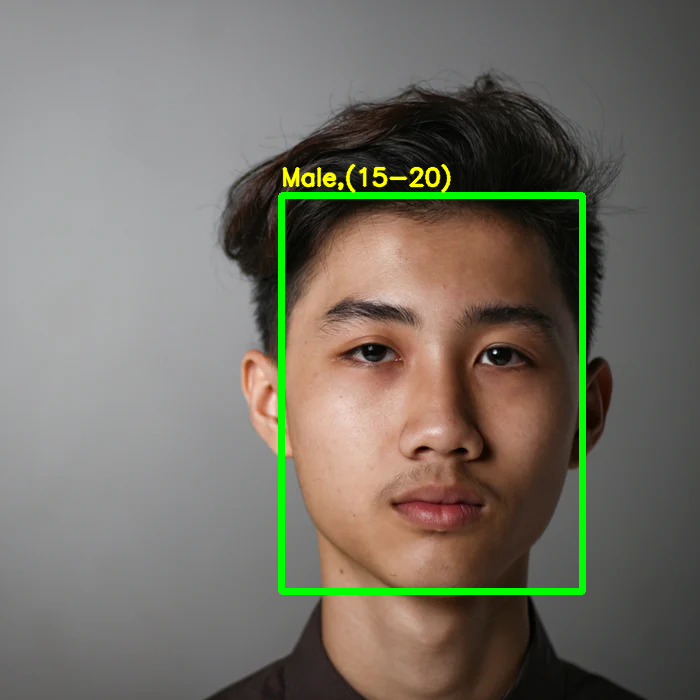

In [25]:
input = cv.imread("/content/drive/MyDrive/147d03f3f4eb2135cc9d2cbba79b048f.png")
output = age_gender_detector(input)
cv2_imshow(output)

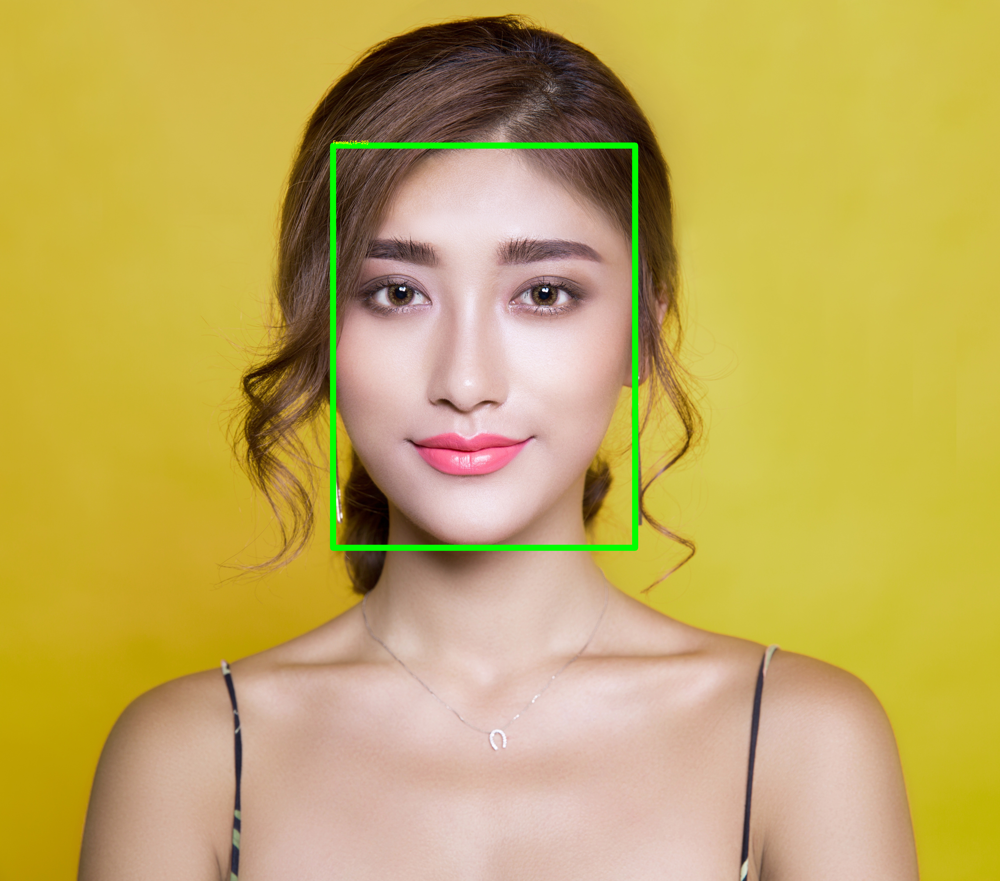

In [33]:
input = cv.imread("/content/drive/MyDrive/model-photo-3.jpg")
output = age_gender_detector(input)
cv2_imshow(output)